# Architectural changes for Transfer Learning - InceptionV3

I tried changing the architecture more this time. This includes increasing the number of trainable neurons and increasing the dropout layers.

In [1]:
import os
import io
import cv2
import keras
import random
from IPython.display import Image
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import PIL
from PIL import Image
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.keras.applications.imagenet_utils import decode_predictions
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.optimizers import Adam
from keras.models import load_model
from keras.preprocessing import image

In [2]:
#os.chdir(r'D:\Data\Train\SFW')
#for im in os.listdir():
#    im2 = Image.open(im)

In [3]:
nsfw_images = [fn for fn in os.listdir(r'D:\Data\Train\NSFW') if fn.endswith('.jpg')]
sfw_images = [fn for fn in os.listdir(r'D:\Data\Train\SFW') if fn.endswith('.jpg')]
train_dir = r'D:\Data\Train'
validation_dir = r'D:\Data\Validation'

In [4]:
pre_trained_model = InceptionV3(input_shape = (150, 150, 3), 
                                include_top=False, 
                                weights = 'imagenet')

for layer in pre_trained_model.layers:
    layer.trainable=False

In [5]:
"""class myCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if(logs.get('acc')>0.959):
            print("\nReached 99.9% accuracy so cancelling training!")
            self.model.stop_training = True"""

'class myCallback(tf.keras.callbacks.Callback):\n    def on_epoch_end(self, epoch, logs={}):\n        if(logs.get(\'acc\')>0.959):\n            print("\nReached 99.9% accuracy so cancelling training!")\n            self.model.stop_training = True'

In [6]:
callback_early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)
callback_reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001)
callback_model_checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath='model.{epoch:02d}-{val_loss:.6f}.h5', save_weights_only=True, 
                                                               monitor='val_acc', mode='max', save_best_only=False)

# Architectural changes

In this architecture, I add 3 fully trainable neuron layers and 2 dropout layers to the output layer. Even though this prevents overfitting to an extent, the final performance is similar to the previous architecture. 

In [7]:
x = layers.Flatten()(pre_trained_model.output)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.2)(x)
x = layers. Dense(2, activation='softmax')(x)

model = Model(pre_trained_model.input, x)
model.compile(optimizer = Adam(lr=0.00001),
             loss='categorical_crossentropy',
             metrics= keras.metrics.BinaryAccuracy())

In [8]:
train_datagen = ImageDataGenerator(rescale = 1./255.,
                                   rotation_range = 40,
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator( rescale = 1.0/255.)

train_generator = train_datagen.flow_from_directory(train_dir,
                                                    batch_size = 30,
                                                    class_mode = 'categorical', 
                                                    target_size = (150, 150))

validation_generator =  test_datagen.flow_from_directory( validation_dir,
                                                          batch_size  = 30,
                                                          class_mode  = 'categorical', 
                                                          target_size = (150, 150))

Found 6363 images belonging to 2 classes.
Found 2124 images belonging to 2 classes.


In [9]:
"""os.chdir(r'D:\Data\Validation\SFW')
i = 0
for file in os.listdir():
    os.rename(file, "sfw_validate_" + str(i) +".jpg")
    i = i+1"""

'os.chdir(r\'D:\\Data\\Validation\\SFW\')\ni = 0\nfor file in os.listdir():\n    os.rename(file, "sfw_validate_" + str(i) +".jpg")\n    i = i+1'

In [10]:
#os.chdir(r'D:\Data\Train\NSFW')
#byteImgIO = io.BytesIO()
#for i in os.listdir():
#    try:
#        byteImg = Image.open(i)
#        byteImg.save(byteImgIO, "PNG")
#        byteImgIO.seek(0)
#        byteImg = byteImgIO.read()
#    except:
#        continue

In [12]:
batch_size = 30
#callbacks = myCallback()
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = int(6363/batch_size),
            epochs = 30,
            validation_steps=int(2124/batch_size),
            verbose=2, callbacks=[callback_early_stopping, callback_reduce_lr, callback_model_checkpoint])

Epoch 1/30


C:\Users\Harshinee Sriram\anaconda3\lib\site-packages\PIL\Image.py:2832: DecompressionBombWarning: Image size (147659204 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


212/212 - 500s - loss: 0.4090 - binary_accuracy: 0.8277 - val_loss: 0.2454 - val_binary_accuracy: 0.9138
Epoch 2/30
212/212 - 480s - loss: 0.3125 - binary_accuracy: 0.8724 - val_loss: 0.2138 - val_binary_accuracy: 0.9252
Epoch 3/30
212/212 - 483s - loss: 0.2860 - binary_accuracy: 0.8874 - val_loss: 0.2044 - val_binary_accuracy: 0.9324
Epoch 4/30
212/212 - 750s - loss: 0.2676 - binary_accuracy: 0.8972 - val_loss: 0.1952 - val_binary_accuracy: 0.9286
Epoch 5/30
212/212 - 766s - loss: 0.2584 - binary_accuracy: 0.9010 - val_loss: 0.2027 - val_binary_accuracy: 0.9262
Epoch 6/30
212/212 - 664s - loss: 0.2546 - binary_accuracy: 0.8991 - val_loss: 0.1923 - val_binary_accuracy: 0.9286
Epoch 7/30
212/212 - 646s - loss: 0.2343 - binary_accuracy: 0.9079 - val_loss: 0.2114 - val_binary_accuracy: 0.9219
Epoch 8/30
212/212 - 659s - loss: 0.2317 - binary_accuracy: 0.9089 - val_loss: 0.1989 - val_binary_accuracy: 0.9271
Epoch 9/30
212/212 - 672s - loss: 0.2308 - binary_accuracy: 0.9079 - val_loss: 0.20

In [13]:
model.save('model_InceptionV3.h5')

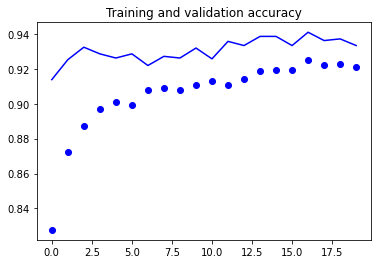

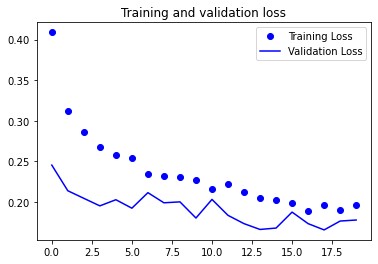

In [14]:
acc = history.history['binary_accuracy']
val_acc = history.history['val_binary_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

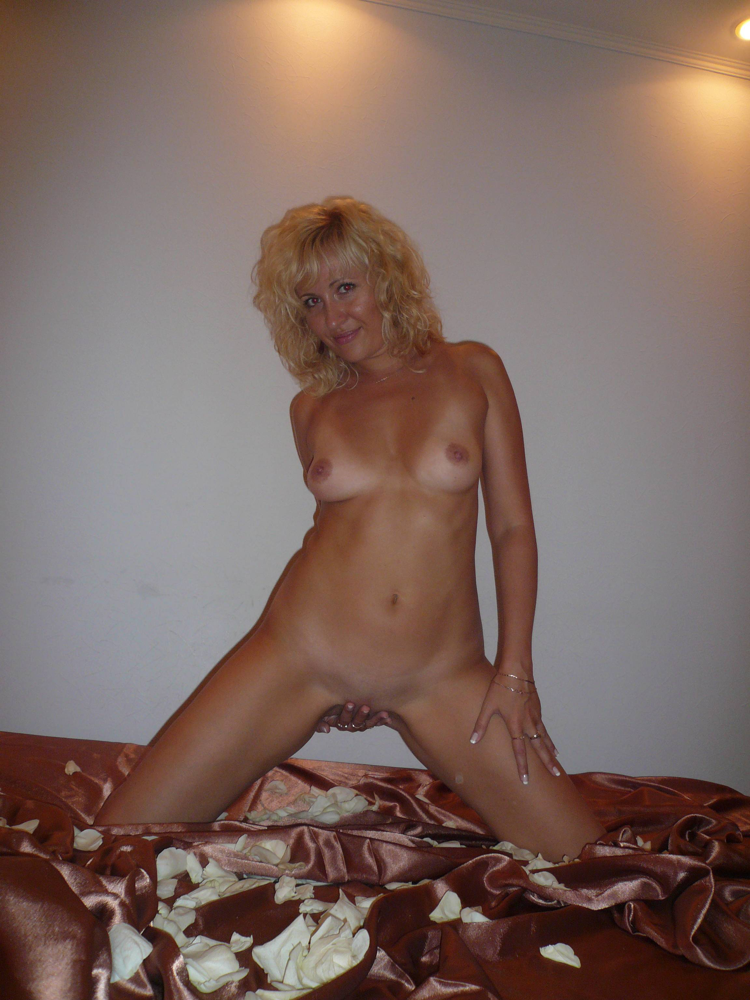

This is an NSFW image


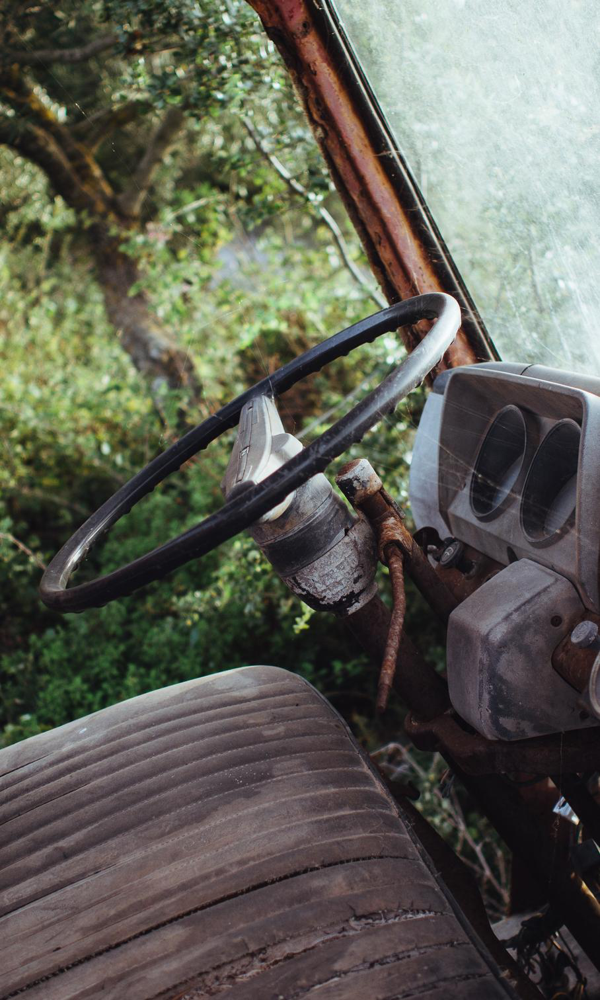

This is a SFW image


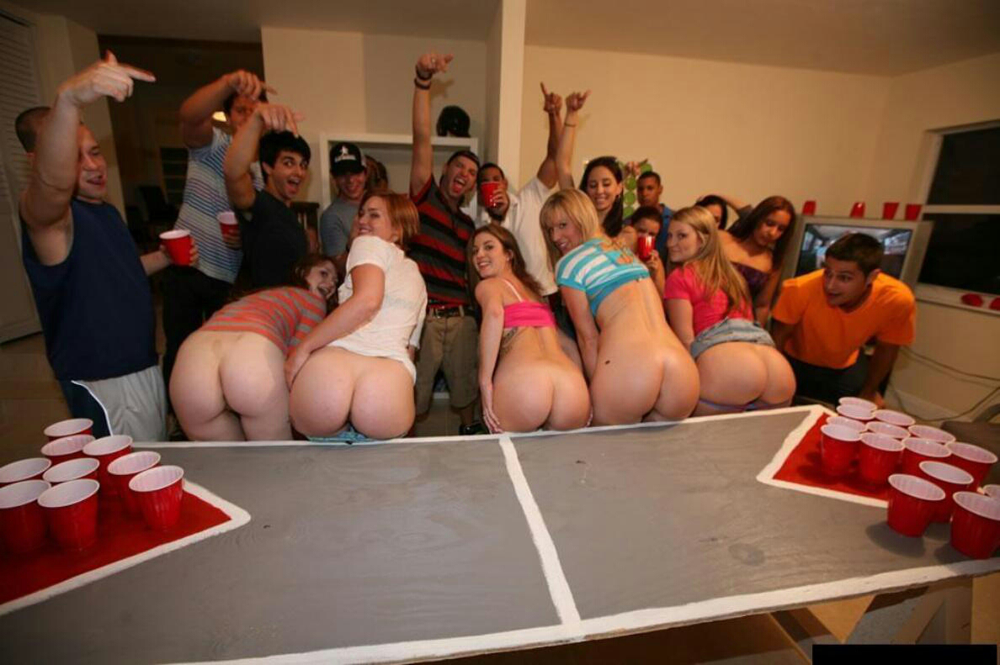

This is an NSFW image


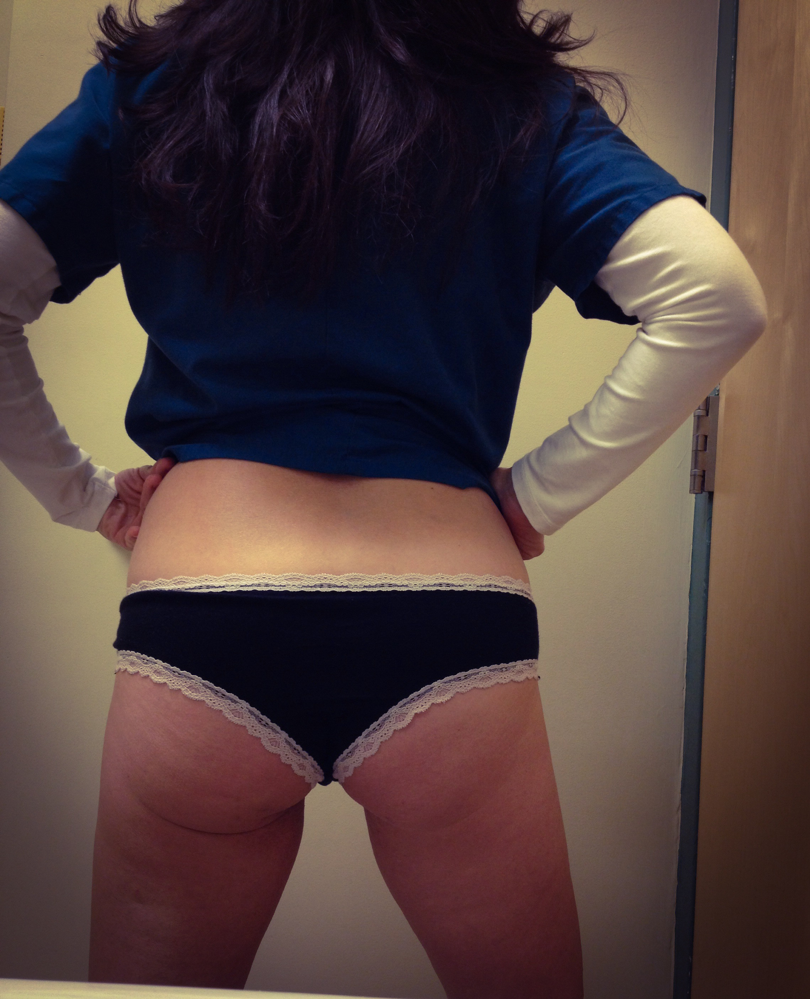

This is an NSFW image


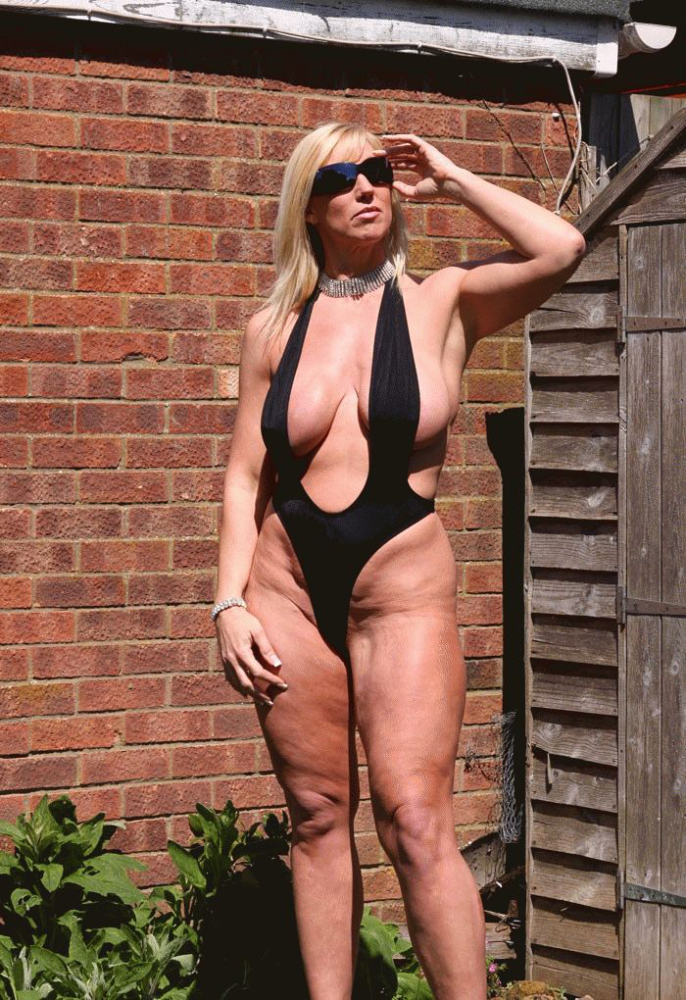

This is an NSFW image


In [16]:
os.chdir(r'D:\Data\Test')

number_of_random_images = 0
img_list = []

while (number_of_random_images<5):
    img_list.append(random.choice(os.listdir(os.getcwd())))
    number_of_random_images = number_of_random_images + 1
    
#img_list2 = ['img 70.jpg', 'img 74.jpg', 'img 100.jpg', 'img 105.jpg']

for test_img in img_list:
    #display(Image(filename=test_img, height=100, width=100))
    display(Image.open(test_img))
    img = image.load_img(test_img, target_size=(150, 150))
    img = image.img_to_array(img)
    img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))
    img = preprocess_input(img)
    yhat = model.predict(img)
    if(np.argmax(yhat) == 0):
        print("This is an NSFW image")
    else:
        print("This is a SFW image")   

# 5. Next steps

I will try implementing a similar structure on the MobileNet model to determine if that works better or similar to the Inception V3.